# Object Localisation Model using MobileNet-v2

In [ ]:
# Download the data
!wget https://www.robots.ox.ac.uk/~vgg/data/pets/data/annotations.tar.gz
!wget https://www.robots.ox.ac.uk/~vgg/data/pets/data/images.tar.gz
!tar --gunzip --extract --verbose --file=annotations.tar.gz
!tar --gunzip --extract --verbose --file=images.tar.gz

In [ ]:
# Pre-process data

import csv
import glob
import os
import xml.etree.ElementTree as ET

XML_FOLDER = "annotations/xmls/"
DATASET_FOLDER = "images/"
TRAIN_OUTPUT_FILE = "train.csv"
VALIDATION_OUTPUT_FILE = "validation.csv"

SPLIT_RATIO = 0.8

def main():
  if not os.path.exists(DATASET_FOLDER):
    print("Dataset not found")
    return

  class_names = {}
  k = 0
  output = []
  xml_files = glob.glob("{}/*xml".format(XML_FOLDER))
  for i, xml_file in enumerate(xml_files):
    tree = ET.parse(xml_file)

    path = os.path.join(DATASET_FOLDER, tree.findtext("./filename"))

    height = int(tree.findtext("./size/height"))
    width = int(tree.findtext("./size/width"))
    xmin = int(tree.findtext("./object/bndbox/xmin"))
    ymin = int(tree.findtext("./object/bndbox/ymin"))
    xmax = int(tree.findtext("./object/bndbox/xmax"))
    ymax = int(tree.findtext("./object/bndbox/ymax"))

    basename = os.path.basename(path)
    basename = os.path.splitext(basename)[0]
    class_name = basename[:basename.rfind("_")].lower()
    if class_name not in class_names:
      class_names[class_name] = k
      k += 1

    output.append((path, height, width, xmin, ymin, xmax, ymax, class_name, class_names[class_name]))

  # preserve percentage of samples for each class ("stratified")
  output.sort(key=lambda tup : tup[-1])

  lengths = []
  i, j = 0, 0
  last = 0
  for j, row in enumerate(output):
    if last == row[-1]:
      i += 1
    else:
      print("class {}: {} images".format(output[j-1][-2], i))
      lengths.append(i)
      i = 1
      last += 1

  print("class {}: {} images".format(output[j-1][-2], i))
  lengths.append(i)

  with open(TRAIN_OUTPUT_FILE, "w") as train, open(VALIDATION_OUTPUT_FILE, "w") as validate:
    writer = csv.writer(train, delimiter=",")
    writer2 = csv.writer(validate, delimiter=",")

    s = 0
    for c in lengths:
      for i in range(c):
        print("{}/{}".format(s + 1, sum(lengths)), end="\r")

        path, height, width, xmin, ymin, xmax, ymax, class_name, class_id = output[s]

        if xmin >= xmax or ymin >= ymax or xmax > width or ymax > height or xmin < 0 or ymin < 0:
            print("Warning: {} contains invalid box. Skipped...".format(path))
            continue

        row = [path, height, width, xmin, ymin, xmax, ymax, class_name, class_names[class_name]]
        if i <= c * SPLIT_RATIO:
            writer.writerow(row)
        else:
            writer2.writerow(row)

        s += 1

  print("\nDone!")

main()

In [ ]:
# Import libraries and define model
import math
from PIL import Image
import numpy as np
from tensorflow.keras import Model
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, Callback
from tensorflow.keras.layers import Conv2D, Reshape
from tensorflow.keras.utils import Sequence
from tensorflow.keras.backend import epsilon

# Tried 0.35, 0.5, 0.75, 1.0
ALPHA = 1.0

# Tried 96, 128, 160, 192, 224
IMAGE_SIZE = 96

TRAIN_CSV = "train.csv"
VALIDATION_CSV = "validation.csv"

def create_model(trainable=False):
  model = MobileNetV2(input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3), include_top=False, alpha=ALPHA)

  # to freeze layers
  for layer in model.layers:
      layer.trainable = trainable

  x = model.layers[-1].output
  x = Conv2D(4, kernel_size=3, name="coords")(x)
  x = Reshape((4,))(x)

  return Model(inputs=model.input, outputs=x)

In [ ]:
# Data Generator

class DataGenerator(Sequence):

  def __init__(self, csv_file):
    self.paths = []

    with open(csv_file, "r") as file:
      self.coords = np.zeros((sum(1 for line in file), 4))
      file.seek(0)

      reader = csv.reader(file, delimiter=",")
      for index, row in enumerate(reader):
        for i, r in enumerate(row[1:7]):
            row[i+1] = int(r)

        path, image_height, image_width, x0, y0, x1, y1, _, _ = row
        self.coords[index, 0] = x0 * IMAGE_SIZE / image_width
        self.coords[index, 1] = y0 * IMAGE_SIZE / image_height
        self.coords[index, 2] = (x1 - x0) * IMAGE_SIZE / image_width
        self.coords[index, 3] = (y1 - y0) * IMAGE_SIZE / image_height 

        self.paths.append(path)

  def __len__(self):
    return math.ceil(len(self.coords) / BATCH_SIZE)

  def __getitem__(self, idx):
    batch_paths = self.paths[idx * BATCH_SIZE:(idx + 1) * BATCH_SIZE]
    batch_coords = self.coords[idx * BATCH_SIZE:(idx + 1) * BATCH_SIZE]

    batch_images = np.zeros((len(batch_paths), IMAGE_SIZE, IMAGE_SIZE, 3), dtype=np.float32)
    for i, f in enumerate(batch_paths):
      img = Image.open(f)
      img = img.resize((IMAGE_SIZE, IMAGE_SIZE))
      img = img.convert('RGB')

      batch_images[i] = preprocess_input(np.array(img, dtype=np.float32))
      img.close()

    return batch_images, batch_coords

class Validation(Callback):
    def __init__(self, generator):
      self.generator = generator

    def on_epoch_end(self, epoch, logs):
      mse = 0
      intersections = 0
      unions = 0

      for i in range(len(self.generator)):
        batch_images, gt = self.generator[i]
        pred = self.model.predict_on_batch(batch_images)
        mse += np.linalg.norm(gt - pred, ord='fro') / pred.shape[0]

        pred = np.maximum(pred, 0)

        diff_width = np.minimum(gt[:,0] + gt[:,2], pred[:,0] + pred[:,2]) - np.maximum(gt[:,0], pred[:,0])
        diff_height = np.minimum(gt[:,1] + gt[:,3], pred[:,1] + pred[:,3]) - np.maximum(gt[:,1], pred[:,1])
        intersection = np.maximum(diff_width, 0) * np.maximum(diff_height, 0)

        area_gt = gt[:,2] * gt[:,3]
        area_pred = pred[:,2] * pred[:,3]
        union = np.maximum(area_gt + area_pred - intersection, 0)

        intersections += np.sum(intersection * (union > 0))
        unions += np.sum(union)

      iou = np.round(intersections / (unions + epsilon()), 4)
      logs["val_iou"] = iou

      mse = np.round(mse, 4)
      logs["val_mse"] = mse

      print(" - val_iou: {} - val_mse: {}".format(iou, mse))

In [ ]:
#Create model 
model = create_model()
model.summary()

In [ ]:
# Train model

EPOCHS = 50
BATCH_SIZE = 32
PATIENCE = 10

MULTI_PROCESSING = False
THREADS = 1

train_datagen = DataGenerator(TRAIN_CSV)
validation_datagen = Validation(generator=DataGenerator(VALIDATION_CSV))

model.compile(loss="mean_squared_error", optimizer="adam", metrics=[])

checkpoint = ModelCheckpoint("model-iou.h5", monitor="val_iou", verbose=1, save_best_only=False,
                              save_weights_only=True, mode="auto")
stop = EarlyStopping(monitor="val_iou", patience=PATIENCE, mode="max")
reduce_lr = ReduceLROnPlateau(monitor="val_iou", factor=0.2, patience=10, min_lr=1e-7, verbose=1, mode="max")

model.fit(train_datagen,
          epochs=EPOCHS,
          callbacks=[validation_datagen, checkpoint, reduce_lr, stop],
          workers=THREADS,
          use_multiprocessing=MULTI_PROCESSING,
          shuffle=True,
          verbose=1)
    

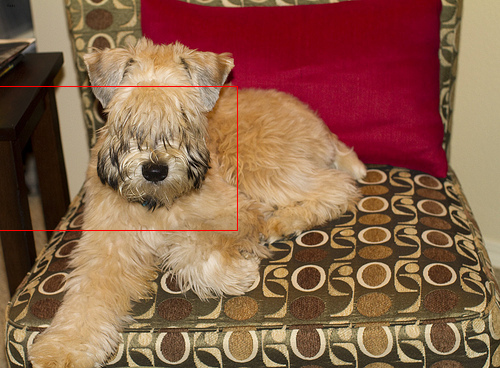

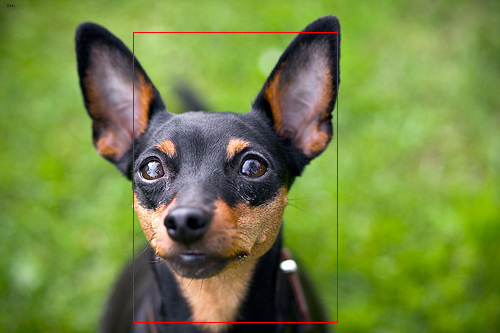

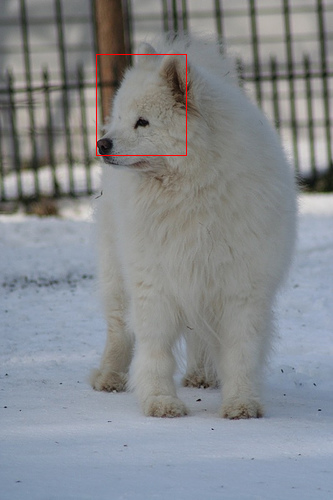

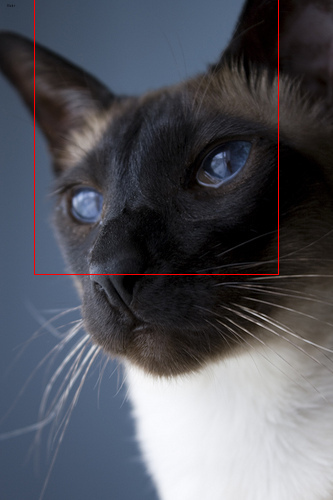

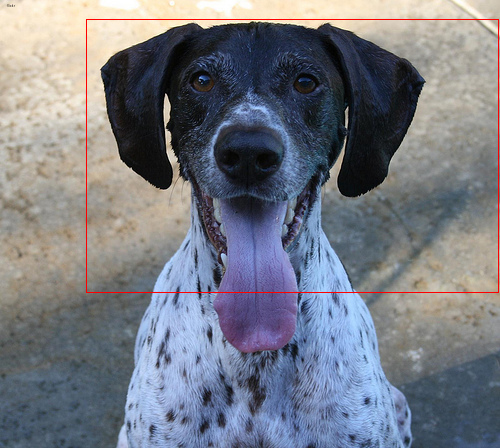

...

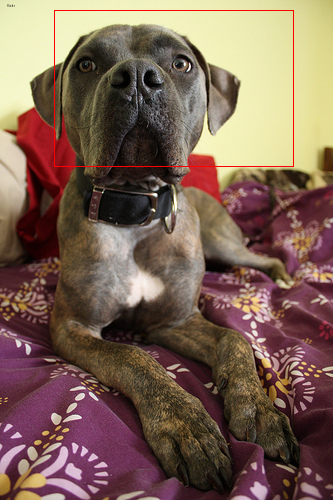

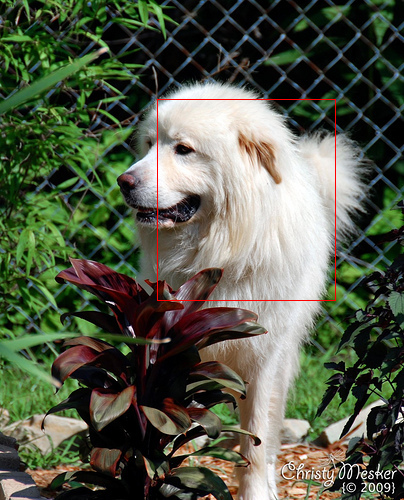

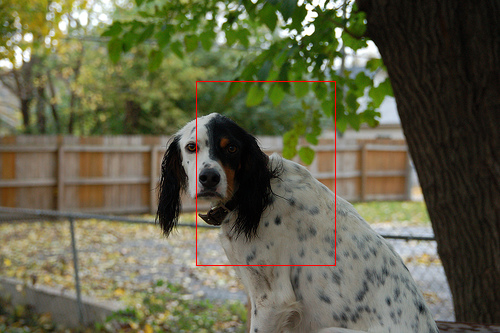

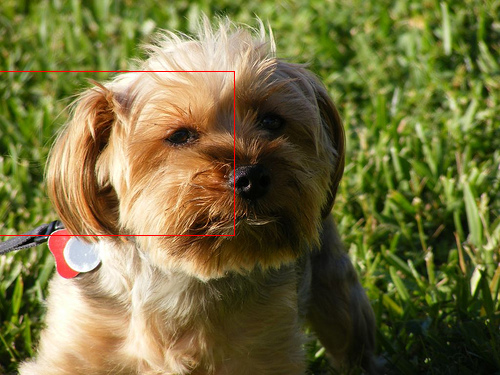

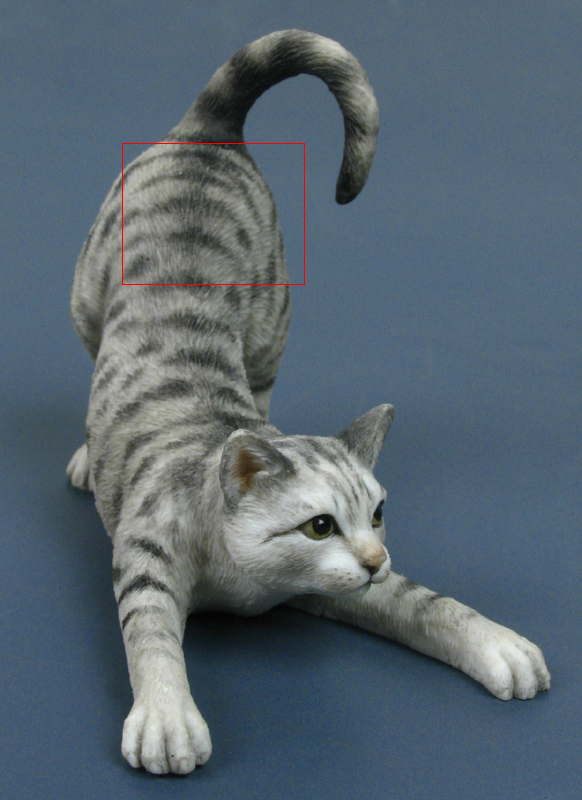

Buffered data was truncated after reaching the output size limit.

In [ ]:
# Test model

import cv2
from google.colab.patches import cv2_imshow

WEIGHTS_FILE = "model-iou.h5"
IMAGES = "images/*.jpg"

# Load models and weights
model = create_model()
model.load_weights(WEIGHTS_FILE)

for filename in glob.glob(IMAGES):
  unscaled = cv2.imread(filename)
  if unscaled is None:
    continue 
  image_height, image_width, _ = unscaled.shape

  image = cv2.resize(unscaled, (IMAGE_SIZE, IMAGE_SIZE))
  feat_scaled = preprocess_input(np.array(image, dtype=np.float32))

  region = model.predict(x=np.array([feat_scaled]))[0]

  x0 = int(region[0] * image_width / IMAGE_SIZE)
  y0 = int(region[1] * image_height / IMAGE_SIZE)

  x1 = int((region[0] + region[2]) * image_width / IMAGE_SIZE)
  y1 = int((region[1] + region[3]) * image_height / IMAGE_SIZE)

  cv2.rectangle(unscaled, (x0, y0), (x1, y1), (0, 0, 255), 1)
  cv2_imshow(unscaled)
  cv2.waitKey(0)
  cv2.destroyAllWindows()